In [1]:
##Import packages
import pandas as pd
import matplotlib.pyplot as plt
from mplsoccer import Pitch, VerticalPitch, arrowhead_marker
import seaborn as sns
import ipywidgets as widgets
from highlight_text import  ax_text, fig_text
from matplotlib.colors import LinearSegmentedColormap
import numpy as np
import warnings

pd.set_option('display.max_columns', None)
#pd.reset_option(“max_columns”)

#Read data
df = pd.read_csv('Footballdata/New/AthleticBilbaovsRealMadrid.csv', encoding='latin-1', low_memory = False)

#Temporary because teams are getting combined together
#df['name'] = df['name'].str.cat(df['teamId'], sep='_')

#Change Offside Passes to Passes
df = df.replace('OffsidePass', 'Pass')

#Adjust to pitch
df['x'] = df['x']*1.2
df['y'] = df['y']*.8
df['endX'] = df['endX']*1.2
df['endY'] = df['endY']*.8

#Replacing NaN values
df.endX.fillna(df.x, inplace=True)
df.endY.fillna(df.y, inplace=True)

#remove substitution events,challenges & formation change
df = df.loc[~(df['type_displayName'] == 'SubstitutionOff')]
df = df.loc[~(df['type_displayName'] == 'SubstitutionOn')]
df = df.loc[~(df['type_displayName'] == 'FormationChange')]
df = df.loc[~(df['type_displayName'] == 'Challenge')]
df = df.loc[~(df['type_displayName'] == 'FormationSet')]
df = df.loc[~(df['type_displayName'] == 'Start')]
df = df.loc[~(df['type_displayName'] == 'End')]
df = df.loc[~(df['type_displayName'] == 'Aerial')]
#df = df.loc[~(df['type/displayName'] == 'Tackle')]

#remove the records of a failed foul, they should be ignored as their challenges are failed and the shot continues
#df = df.loc[~((df['type/displayName'] == 'Foul') & (df['outcomeType/displayName'] == 'Unsuccessful'))]

#remove the records of a corners awarded, they should be ignored as their challenges are failed and the shot continues
#df = df.loc[~((df['type/displayName'] == 'CornerAwarded') & (df['outcomeType/displayName'] == 'Unsuccessful'))]

#List it in a combo box
options = df["name"].unique()
options = options.tolist()

options = [x for x in options if str(x) != 'nan']
playerlist = widgets.Combobox(
    placeholder='Enter a name',
    options=options,
    description='Player:',
    ensure_option=True,
    disabled=False
)
playerlist

Combobox(value='', description='Player:', ensure_option=True, options=('Iñaki Williams', 'Iker Muniain', 'Íñig…

In [2]:
player = playerlist.value

#Take Ons
TakeOns = df.loc[df['type_displayName']== 'TakeOn']

#Filter for Unsuccessful Actions for listing
Unsuccessful_TakeOns = TakeOns.loc[(TakeOns['outcomeType_displayName'] == 'Unsuccessful')]

#Filter for Successful Actions for listing
Successful_TakeOns = TakeOns.loc[(TakeOns['outcomeType_displayName']== "Successful")]

#List of Take-Ons Attempts
takeons_list = TakeOns.groupby(['name','teamId']).size().reset_index().rename(columns={0:'Take-Ons'}).sort_values('name', ascending = True).reset_index()
del takeons_list['index']

#List of Successful Take-Ons
successful_takeons_list = Successful_TakeOns.groupby(['name','teamId']).size().reset_index().rename(columns={0:'Successful Take-Ons'}).sort_values('name', ascending = True).reset_index()
del successful_takeons_list['index']

#Merge the two lists
TakeOns_List = pd.merge(takeons_list, successful_takeons_list, on="name")
TakeOns_List = TakeOns_List.drop(['teamId_y'], axis = 1)
TakeOns_List.rename(columns = {'teamId_x':'Team', 'name':'Recipient'},inplace = True)
TakeOns_List = TakeOns_List.sort_values('Successful Take-Ons', ascending= False).reset_index(drop = True)
TakeOns_List = TakeOns_List.drop(['Team'], axis = 1)

#TakeOns_List.head(10)

In [3]:
#Filter for ball touches and whether it is a ball recovery
actions = df.loc[(df['isTouch'] == True)
                |(df['type_displayName'] == 'BallRecovery')]

#Taking the variables that are needed
actions = actions[['expandedMinute', 'teamId','type_displayName','outcomeType_displayName','name',
                   'x', 'y', 'endX', 'endY']]

#finding the Recipient of the action/pass made
actions['Recipient'] = actions['name'].shift(-1)

#finding the next event that occured along with the x & y positions
actions['nextEvent'] = actions['type_displayName'].shift(-1)
actions['2ndnextEvent'] = actions['type_displayName'].shift(-2)
actions['x_next'] = actions['x'].shift(-1)
actions['y_next'] = actions['y'].shift(-1)
actions['outcomeType_next'] = actions['outcomeType_displayName'].shift(-1)

#find if the next event is by the same team
actions['teamId_next'] = actions['teamId'].shift(-1)
actions['2ndteamId_next'] = actions['teamId'].shift(-2)

actions = actions.loc[ (actions['nextEvent'] == 'Pass')
                      |(actions['nextEvent'] == 'TakeOn')
                      |(actions['nextEvent'] == 'Dispossessed')
                      |(actions['nextEvent'] == 'BallRecovery')
                      |(actions['nextEvent'] == 'MissedShots')
                      |(actions['nextEvent'] == 'ShotOnPost')
                      |(actions['nextEvent'] == 'Goal')
                      |(actions['nextEvent'] == 'GoodSkill')
                      |(actions['nextEvent'] == 'SavedShot')
                      |(actions['nextEvent'] == 'BallTouch')  
                      |((actions['nextEvent'] == 'Foul') & (actions['outcomeType_next'] == 'Successful'))
                      |((actions['nextEvent'] == 'CornerAwarded') & (actions['outcomeType_next'] == 'Successful'))]

#to calculate the distance between the carried distance, using Euclidean formula
#needs to be more than or equals to a certain value
min_dribble_length = 5
max_dribble_length = 70
far_enough = (actions['x_next']-actions['endX'])**2 + (actions['y_next'] - actions['endY'])**2 >= min_dribble_length**2
far_enough2 = (actions['x_next']-actions['endX'])**2 + (actions['y_next'] - actions['endY'])**2 <= max_dribble_length**2

#Check if next team is the same team
same_team = actions['teamId'] == actions['teamId_next']

#filter to find the carries
carries = actions[(far_enough) & (same_team) & (far_enough2)]

#remove the records of a foul after having it set as the next event.
carries = carries.loc[~((carries['type_displayName'] == 'Foul'))].reset_index()
#carries = carries.loc[~((carries['type/displayName'] == 'Dispossessed'))].reset_index()

#if next event takes place in the corner flag, something must be wrong
carries = carries.loc[~((carries['x_next'] >= 119.1))].reset_index()

#New variables to check the distance between the beginning location and end location to the goal (goalline)
carries['beginning'] = np.sqrt(np.square(120-carries['endX'])+np.square(40-carries['endY']))
carries['end'] = np.sqrt(np.square(120-carries['x_next'])+np.square(40-carries['y_next']))
carries['distance'] = carries['beginning'] - carries['end']
#carries['25%'] = carries['end'] / carries['beginning'] <.75

#carries['progressive'] = [(carries['end'][x]) / (carries['beginning'][x]) <.85 for x in range(len(carries.beginning))]

#remove carries starting from the penalty area
#carriesdf = carriesdf.loc[~((carriesdf['endY'].between(18,62) & (carriesdf['endX'] > 102)))]
#carriesdf = carriesdf.loc[carriesdf['endX'] > 48]

#Progressive Carries (carries need to end in the attacking 50% of the pitch)
#carries['Progressive_Carry'] = np.where((carries['progressive']== True) & (carries['endX'] < carries['x_next']) &(carries['x_next'] >= 60),1,0)


#Carries into Penalty Area 
carries['Penalty_Entries'] = np.where(((carries['y_next'].between(16.88,63.12)) & (carries['x_next']> 99.6)) &
                                      ((carries['endX'] < 99.6) | (carries['endY'] < 16.88) | (carries['endY'] > 63.12)) , 1, 0)
CPAcarriesdf = carries.loc[carries['Penalty_Entries'] == 1]

# At least 30m closer to the opponent’s goal if the starting and finishing points are within a team’s own half
# At least 15m closer to the opponent’s goal if the starting and finishing points are in different halves
# At least 10m closer to the opponent’s goal if the starting and finishing points are in the opponent’s half
# 25% closer towards goal
carries['Progressive_Carry'] = np.where(((carries['endX']< 60) & (carries['x_next']< 60) & (carries['distance']>=32.80)) |
                      ((carries['endX']< 60) & (carries['x_next']>=60) & (carries['distance']>=16.40)) |
                      ((carries['endX']>=60) & (carries['x_next']>=60) & (carries['distance']>=10.94)) |
                       (carries['Penalty_Entries'] == 1) ,1,0)

#Progressive Carries -> Pcarriesdf
Pcarriesdf = carries.loc[carries['Progressive_Carry'] == 1]

#List of shots
list1 = ["SavedShot", "ShotOnPost","MissedShots","Goal"]

#Shot-Ending Carries
carries['Shot_Ending_Carry'] = np.where(carries['nextEvent'].isin(list1), 1,0)
#Shot-Ending Carries -> SEcarriesdf
SEcarriesdf = carries.loc[carries['Shot_Ending_Carry'] == 1]

#Goal-Ending Carries
carries['Goal_Ending_Carry'] = np.where(carries['nextEvent'] == 'Goal', 1,0)
#Goal-Ending Carries -> GEcarriesdf
GEcarriesdf = carries.loc[carries['Goal_Ending_Carry'] == 1]

#KeyPass Ending Carries
carries['KeyPass_Ending_Carry'] = np.where( (carries['2ndnextEvent'].isin(list1)) & 
                                            (carries['nextEvent'] == 'Pass') &
                                            (carries['2ndteamId_next'] == carries['teamId_next']),1,0)
#KeyPass-Ending Carries -> KPcarriesdf
KPcarriesdf = carries.loc[carries['KeyPass_Ending_Carry'] == 1]

#Assist Ending Carries
carries['Assist_Ending_Carry'] = np.where( (carries['2ndnextEvent'] == 'Goal') & 
                                           (carries['nextEvent'] == 'Pass') &
                                           (carries['2ndteamId_next'] == carries['teamId_next']),1,0)
#Assist-Ending Carries -> KPcarriesdf
Acarriesdf = carries.loc[carries['Assist_Ending_Carry'] == 1]

#Foul-Winning Carries
carries['Foul_Winning_Carry'] = np.where(carries['nextEvent'] == 'Foul', 1,0)
#Foul Winning Carries -> FWcarriesdf
FWcarriesdf = carries.loc[carries['Foul_Winning_Carry'] == 1]


#Carries into Final Third
carries['Final_Third'] = np.where((carries['endX']< 80) & (carries['x_next']>= 80), 1, 0)
CFTcarriesdf = carries.loc[carries['Final_Third'] == 1]

#Wide Prog_Carries
carries['Wide_ProgCarry'] =  np.where(((carries['endY'].between(0,16.88)) | (carries['endY'].between(63.12,80))) &
                                      ((carries['y_next'].between(0,16.88)) | (carries['y_next'].between(63.12,80))) &
                                       (carries['Progressive_Carry'] == 1) ,1,0)

WPcarriesdf = carries.loc[carries['Wide_ProgCarry'] == 1]

#Central Progressive Carries
carries['Central_ProgCarry'] =  np.where(((carries['endY'].between(16.88, 63.12)) & (carries['endX'].between(20.4, 99.6))) &
                                         ((carries['y_next'].between(16.88, 63.12)) & (carries['x_next'].between(20.4, 99.6))) &
                                          (carries['Progressive_Carry'] == 1) ,1,0)

CPcarriesdf = carries.loc[carries['Central_ProgCarry'] == 1]

In [4]:
#List of Carries
carries_list = carries.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Total Carries'}).sort_values('Recipient', ascending = False).reset_index()
del carries_list['index']

#List of Progressive Carries
progressive_carries_list = Pcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Progressive Carries'}).sort_values('Recipient', ascending = False).reset_index()
del progressive_carries_list['index']

#List of ShotEnding Carries
shot_ending_carries_list = SEcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Shot-Ending Carries'}).sort_values('Recipient', ascending = False).reset_index()
del shot_ending_carries_list['index']

#List of GoalEnding Carries
goal_ending_carries_list = GEcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Goal-Ending Carries'}).sort_values('Recipient', ascending = False).reset_index()
del goal_ending_carries_list['index']

#List of Key Pass Ending Carries
keypass_ending_carries_list = KPcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'KeyPass Ending Carries'}).sort_values('Recipient', ascending = False).reset_index()
del keypass_ending_carries_list['index']

#List of Assist Ending Carries
assist_ending_carries_list = Acarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Assist Ending Carries'}).sort_values('Recipient', ascending = False).reset_index()
del assist_ending_carries_list['index']

#List of Foul Winning Carries
foulwinning_carries_list = FWcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Foul Winning Carries'}).sort_values('Recipient', ascending = False).reset_index()
del foulwinning_carries_list['index']

#List of Carries in Penalty Box
penalty_carries_list = CPAcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Penalty Entry Carries'}).sort_values('Recipient', ascending = False).reset_index()
del penalty_carries_list['index']

#List of Carries into Final Third
Finalthird_carries_list = CFTcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Final Third Entry Carries'}).sort_values('Recipient', ascending = False).reset_index()
del Finalthird_carries_list['index']

#List of Wide Progressive Carries
WideProg_carries_list = WPcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Wide Progressive Carries'}).sort_values('Recipient', ascending = False).reset_index()
del WideProg_carries_list['index']

#List of Wide Progressive Carries
CentralProg_carries_list = CPcarriesdf.groupby(['Recipient','teamId']).size().reset_index().rename(columns={0:'Central Progressive Carries'}).sort_values('Recipient', ascending = False).reset_index()
del CentralProg_carries_list['index']

#Total List
carrieslist = pd.merge(pd.merge(pd.merge(pd.merge(pd.merge(pd.merge(pd.merge(pd.merge(pd.merge(pd.merge(pd.merge(carries_list, progressive_carries_list, how = 'outer'),
              shot_ending_carries_list, how = 'outer'), goal_ending_carries_list, how = 'outer'),   
              keypass_ending_carries_list, how = 'outer'), assist_ending_carries_list, how = 'outer'),
              foulwinning_carries_list, how = 'outer'), Finalthird_carries_list, how = 'outer'),
              penalty_carries_list, how = 'outer'), WideProg_carries_list, how='outer'), 
              CentralProg_carries_list, how='outer'), TakeOns_List, how='outer')

carrieslist.fillna(0, inplace=True)
carrieslist.rename(columns = {'teamId':'Team', 'Recipient':'Player'},inplace = True)
carrieslist = carrieslist.sort_values('Central Progressive Carries', ascending= False).reset_index(drop = True)
carrieslist.index += 1

#Convert to integer
carrieslist['Total Carries'] = carrieslist['Total Carries'].astype(int)
carrieslist['Progressive Carries'] = carrieslist['Progressive Carries'].astype(int)
carrieslist['Shot-Ending Carries'] = carrieslist['Shot-Ending Carries'].astype(int)
carrieslist['Goal-Ending Carries'] = carrieslist['Goal-Ending Carries'].astype(int)
carrieslist['KeyPass Ending Carries'] = carrieslist['KeyPass Ending Carries'].astype(int)
carrieslist['Assist Ending Carries'] = carrieslist['Assist Ending Carries'].astype(int)
carrieslist['Penalty Entry Carries'] = carrieslist['Penalty Entry Carries'].astype(int)
carrieslist['Total Carries'] = carrieslist['Total Carries'].astype(int)
carrieslist['Take-Ons'] = carrieslist['Take-Ons'].astype(int)
carrieslist['Successful Take-Ons'] = carrieslist['Successful Take-Ons'].astype(int)
carrieslist['Foul Winning Carries'] = carrieslist['Foul Winning Carries'].astype(int)
carrieslist['Final Third Entry Carries'] = carrieslist['Final Third Entry Carries'].astype(int)
carrieslist['Wide Progressive Carries'] = carrieslist['Wide Progressive Carries'].astype(int)
carrieslist['Central Progressive Carries'] = carrieslist['Central Progressive Carries'].astype(int)

carrieslist['Player'] = carrieslist['Player'].str.split('_').str[0]
carrieslist.head(20)

#carrieslist.loc[carrieslist['Team'] == 'Atalanta']

,Player,Team,Total Carries,Progressive Carries,Shot-Ending Carries,Goal-Ending Carries,KeyPass Ending Carries,Assist Ending Carries,Foul Winning Carries,Final Third Entry Carries,Penalty Entry Carries,Wide Progressive Carries,Central Progressive Carries,Take-Ons,Successful Take-Ons
1,Eduardo Camavinga,52,20,4,0,0,0,0,3,2,0,1,2,2,1
2,Aitor Paredes,53,8,1,0,0,0,0,0,1,0,0,1,0,0
3,Rodrygo,52,16,6,1,0,0,0,0,3,1,1,1,0,0
4,Fran García,52,22,2,1,0,0,0,0,1,0,1,1,0,0
5,Jude Bellingham,52,9,4,0,0,1,0,0,2,0,2,1,4,3
6,David Alaba,52,24,1,0,0,0,0,0,0,0,0,1,0,0
7,Mikel Vesga,53,9,1,0,0,0,0,0,0,0,0,1,0,0
8,Dani Vivian,53,7,1,0,0,0,0,0,1,0,0,1,0,0
9,Iker Muniain,53,6,1,0,0,0,0,0,0,0,0,1,3,1
10,Vinícius Júnior,52,15,7,2,0,0,0,2,3,3,2,1,9,3


In [5]:
#Chance Creating Carries (Additional)
carrieslist['Total'] = carrieslist['Shot-Ending Carries'] + carrieslist['KeyPass Ending Carries'] + carrieslist['Foul Winning Carries']

chance_carrieslist = carrieslist[['Player', 'Team', 'Shot-Ending Carries', 'KeyPass Ending Carries', 'Foul Winning Carries', 'Total']]

chance_carrieslist = chance_carrieslist.sort_values('Total', ascending= False).reset_index(drop = True)
chance_carrieslist.index += 1

print('Top 15 Chance-Creating Carriers in the Premier League (2022/23) | Source: Opta | @chunhang7')
chance_carrieslist.head(15)

Top 15 Chance-Creating Carriers in the Premier League (2022/23) | Source: Opta | @chunhang7


,Player,Team,Shot-Ending Carries,KeyPass Ending Carries,Foul Winning Carries,Total
1,Xavi Simons,PSV,31,26,29,86
2,Václav Cerny,FC Twente,47,30,3,80
3,Virgil Misidjan,FC Twente,35,20,23,78
4,Steven Bergwijn,Ajax,39,17,15,71
5,Elayis Tavsan,NEC Nijmegen,38,10,20,68
6,Oussama Tannane,NEC Nijmegen,22,18,24,64
7,Javairô Dilrosun,Feyenoord,34,17,11,62
8,Bobby Adekanye,Go Ahead Eagles,16,14,31,61
9,Million Manhoef,Vitesse,40,14,7,61
10,Jens Odgaard,AZ Alkmaar,31,11,16,58


In [6]:
#Filter for player
carries = carries.loc[carries['Recipient'] == player]
carrycount = len(carries.index)

pcarries = Pcarriesdf.loc[Pcarriesdf['Recipient'] == player]
progcarrycount = len(pcarries.index)

secarries = SEcarriesdf.loc[SEcarriesdf['Recipient'] == player]
secarrycount = len(secarries.index)

gecarries = GEcarriesdf.loc[GEcarriesdf['Recipient'] == player]
gecarrycount = len(gecarries.index)

kpcarries = KPcarriesdf.loc[KPcarriesdf['Recipient'] == player]
kpcarrycount = len(kpcarries.index)

acarries = Acarriesdf.loc[Acarriesdf['Recipient'] == player]
acarrycount = len(acarries.index)

fwcarries = FWcarriesdf.loc[FWcarriesdf['Recipient'] == player]
gecarrycount = len(gecarries.index)

Unsuccessful_TakeOns = TakeOns.loc[(TakeOns['outcomeType_displayName'] == 'Unsuccessful') & (TakeOns['name'] == player)]
unsuccessful = len(Unsuccessful_TakeOns.index)

Successful_TakeOns = TakeOns.loc[(TakeOns['outcomeType_displayName']== "Successful") & (TakeOns['name'] == player)]
successful = len(Successful_TakeOns.index)

#Retrieve team name from the carries
team = carries['teamId'].unique()
team = team[0]

#Retrieve Opposition team
oppo = df.loc[(df['teamId']!= team)]
oppo = oppo['teamId'].unique()
oppo = oppo[0]

In [10]:
import matplotlib as mpl

#Set up pitch
mpl.rcParams['figure.dpi'] = 500
pitch = VerticalPitch(pitch_type='statsbomb', 
                      pitch_color='#000000', line_color='white',half = True,
                      line_zorder=1, linewidth=8, spot_scale=0.003)

fig,ax = pitch.draw(figsize=(30, 20), constrained_layout=False, tight_layout=True)
fig.set_facecolor('#000000')

#Inverse the y-axis
plt.gca().invert_xaxis()

#Successful Progressive Carries
pitch.scatter(pcarries.endX,pcarries.endY, edgecolors= 'yellow', c='#008140',
              s = 600, zorder=4, ax=ax, marker = 'o', linewidth=4)

pitch.lines(pcarries.endX,pcarries.endY,pcarries.x_next,pcarries.y_next, ls='dashed',
            ax=ax, color= '#00c631', lw=6, alpha = 0.8)

pitch.scatter(pcarries.x_next,pcarries.y_next, edgecolors= 'yellow', c='#008140',marker=arrowhead_marker,
              s = 1000, zorder=4, ax=ax, linewidth=4)

#Successful Shot-Ending Carries
pitch.scatter(secarries.endX, secarries.endY, edgecolors= 'yellow', c='#e80505',
              s = 600, zorder=4, ax=ax, marker = 'o', linewidth=4)

pitch.lines(secarries.endX,secarries.endY,secarries.x_next,secarries.y_next, ls='dashed',
            ax=ax, color= '#e80505', lw=6, alpha = 0.8)

pitch.scatter(secarries.x_next, secarries.y_next,  edgecolors= 'yellow', c='#e80505',marker=arrowhead_marker,
              s = 1000, zorder=4, ax=ax, linewidth=4)

#Title & Annotations
fig.suptitle("\n\nMohammed Kudus's Carries Map\nEredivisie | 2022/23\n\n", fontsize=65, color='yellow',
            fontfamily = "Courier New", fontweight = "bold",y=0.93)

highlight_textprops =\
    [{"color": "#00c631","fontweight": 'bold'},
     {"color": "red","fontweight": 'bold'}]

Title = fig_text(s = "<Prog. Carries:> " + str(progcarrycount) + " | <Shot-Ending Carries:> " + str(secarrycount) ,
        x = 0.5, y = 0.73, highlight_textprops = highlight_textprops ,color='white',
        fontfamily = "Courier New",fontweight='bold', ha='center',fontsize=45)

ax.text(-4, 68, 'space', va='center', ha='left', fontsize=25, color='black',
        fontweight = "bold",fontfamily = "Courier New")

ax.text(89, 68, 'space', va='center', ha='left', fontsize=25, color='black',
        fontweight = "bold",fontfamily = "Courier New")

ax.text(25, 62, '@chunhang7 | Data via Opta', va='center', ha='left', fontsize=23, color='w',
        fontweight = "bold",fontfamily = "Courier New", zorder=8)

plt.show()

In [8]:
#Set up pitch
pitch = VerticalPitch(pitch_type='statsbomb', 
                  pitch_color='#000000', line_color='white',half = False,
                  line_zorder=1, linewidth=5, spot_scale=0.006)

fig,ax = pitch.draw(figsize=(30, 20), constrained_layout=False, tight_layout=True)
fig.set_facecolor('#000000')

#Inverse the x-axis
plt.gca().invert_xaxis()


#Successful Progressive Carries
pitch.scatter(pcarries.endX,pcarries.endY, edgecolors= 'yellow', c='#008140',
              s = 500, zorder=4, ax=ax, marker = 'o', linewidth=3)

pitch.lines(pcarries.endX,pcarries.endY,pcarries.x_next,pcarries.y_next, ls='dashed',
            ax=ax, color= '#00c631', lw=5, alpha = 0.8)

pitch.scatter(pcarries.x_next,pcarries.y_next, edgecolors= 'yellow', c='#008140',marker=arrowhead_marker,
              s = 500, zorder=4, ax=ax, linewidth=3)


#Successful Shot-Ending Carries
pitch.scatter(secarries.endX, secarries.endY, edgecolors= 'yellow', c='#e80505',
              s = 500, zorder=4, ax=ax, marker = 'o', linewidth=3)

pitch.lines(secarries.endX,secarries.endY,secarries.x_next,secarries.y_next, ls='dashed',
            ax=ax, color= '#e80505', lw=5, alpha = 0.8)

pitch.scatter(secarries.x_next, secarries.y_next,  edgecolors= 'yellow', c='#e80505',marker=arrowhead_marker,
              s = 500, zorder=4, ax=ax, linewidth=3)


"""#Successful Carries
pitch.scatter(kpcarries.endX, kpcarries.endY, edgecolors= 'yellow', c='#973cff',
              s = 500, zorder=4, ax=ax, marker = 'o', linewidth=3)

pitch.lines(kpcarries.endX, kpcarries.endY, kpcarries.x_next, kpcarries.y_next, ls='dashed',
            ax=ax, color= '#973cff', lw=5, alpha = 0.8)

pitch.scatter(kpcarries.x_next, kpcarries.y_next,  edgecolors= 'yellow', c='#973cff',marker=arrowhead_marker,
              s = 500, zorder=4, ax=ax, linewidth=3)"""

#Title
plt.text(40,121,"Nicolas's Carries Map\nSerie A | 2022/23\n\n",color='yellow', ha='center',
          size=40, fontfamily = "Courier New", fontweight = "bold")

highlight_textprops =\
    [{"color": "lightgreen","fontweight": 'bold'},
     {"color": "red","fontweight": 'bold'}
    ]


Title = fig_text(s = "<Progressive> | <Shot-Ending> ",
        x = 0.5, y = 0.87, highlight_textprops = highlight_textprops ,color='yellow',
        fontfamily = "Courier New",fontweight='bold', ha='center',fontsize=32)

#Draw line
ax.plot([0,80], [80, 80], c='yellow', lw=3.5, ls='-.', zorder=9, alpha=0.9)

#shade
plt.axhspan(80,119.5,xmin=0.05,xmax=0.96,color='lightgrey',zorder=-1,alpha=0.25)

"""
Title = fig_text(s = str(progcarrycount) + " <Progressive> | " 
                 + str(secarrycount) + " <Shot-Ending> | "
                 + str(kpcarrycount) + " <Key Pass-Ending>",
        x = 0.5, y = 0.885, highlight_textprops = highlight_textprops ,color='yellow',
        fontfamily = "Courier New",fontweight='bold', ha='center',fontsize=25);
"""

#Space
ax.text(45, 142, 'Space', va='center', ha='left', fontsize=25, color='black',fontweight='bold',fontfamily='Courier New')
ax.text(-5, -10, 'Space', va='center', ha='left', fontsize=25, color='black',fontweight='bold',fontfamily='Courier New')
ax.text(93, -10, 'Space', va='center', ha='left', fontsize=25, color='black',fontweight='bold',fontfamily='Courier New')

plt.show()

In [9]:
#Make the pitch
pitch = Pitch(pitch_type='statsbomb', pitch_color='#1b2431', line_color='w',linewidth=5, spot_scale=0.005)
fig, ax = pitch.draw(figsize=(20, 15), constrained_layout=False, tight_layout=True)
fig.set_facecolor('#1b2431')

#inverse y-axis
plt.gca().invert_yaxis()

#plot carries (lines)
pitch.lines(carries.endX,carries.endY,carries.x_next,carries.y_next,
            ax=ax, comet = True, linewidth=10, capstyle='round', zorder=1,
            alpha=0.03, color ='#aacfec')

#plot progressive carries (lines)
pitch.lines(pcarries.endX, pcarries.endY, pcarries.x_next, pcarries.y_next,
            ax=ax,comet = True, color= '#1bd149', lw=18, alpha = 0.5)

pitch.scatter(pcarries.x_next, pcarries.y_next, edgecolors= '#1bd149', c='w',
              s = 800, zorder=4, ax=ax, marker = 'o',alpha=0.9, linewidths=5)

#plot ShotEnding carries (lines)
pitch.lines(secarries.endX, secarries.endY, secarries.x_next, secarries.y_next,
            ax=ax,comet = True, color= '#e80505', lw=18, alpha = 0.5)

pitch.scatter(secarries.x_next, secarries.y_next, edgecolors= '#e80505', c='w',
              s = 800, zorder=4, ax=ax, marker = 'o',alpha=0.9, linewidths=5)

if gecarries.empty == False:
    pitch.scatter(gecarries.x_next, gecarries.y_next, edgecolors= '#e80505', c='yellow',
                   s = 1500, zorder=4, ax=ax, marker = 'o',alpha=0.9, linewidths=5)

#plot Foul Winning carries (lines)
pitch.lines(fwcarries.endX, fwcarries.endY, fwcarries.x_next, fwcarries.y_next,
            ax=ax,comet = True, color= '#00FFFF', lw=18, alpha = 0.5)

pitch.scatter(fwcarries.x_next, fwcarries.y_next, edgecolors= '#00FFFF', c='w',
              s = 800, zorder=4, ax=ax, marker = 'o',alpha=0.9, linewidths=5)

#plot Key Pass ending carries (lines)
pitch.lines(kpcarries.endX, kpcarries.endY, kpcarries.x_next, kpcarries.y_next,
            ax=ax,comet = True, color= '#973cff', lw=18, alpha = 0.5)

pitch.scatter(kpcarries.x_next, kpcarries.y_next, edgecolors= '#973cff', c='w',
              s = 800, zorder=4, ax=ax, marker = 'o',alpha=0.9, linewidths=5)

if acarries.empty == False:
    pitch.scatter(acarries.x_next, acarries.y_next, edgecolors= '#973cff', c='yellow',
                   s = 1500, zorder=4, ax=ax, marker = 'o',alpha=0.9, linewidths=5)

#Plot take-ons
pitch.scatter(Successful_TakeOns.x, Successful_TakeOns.y, marker='X', s=2000, c='#fff000', linewidth = 5, ax=ax,
              edgecolor='black', zorder = 5, alpha=0.8)

#Title & Annotations
fig.suptitle(player +"'s Carries Map", fontsize=55, color='yellow',
            fontfamily = "Courier New", fontweight = "bold",y=1.005)


highlight_textprops =\
    [{"color": "#1bd149","fontweight": 'bold'},
     {"color": "#e80505","fontweight": 'bold'},
     {"color": "#d24ffe","fontweight": 'bold'},
     {"color": "#00FFFF","fontweight": 'bold'},
     {"color": "#fff000","fontweight": 'bold'}
    ]

Title = fig_text(s = "<Progressive> | <Shot-Ending> | <Key Pass Ending> | <Foul-Winning> | <Take-Ons>" ,
        x = 0.5, y = 0.94, highlight_textprops = highlight_textprops ,color='white',
        fontfamily = "Courier New",fontweight='bold', ha='center',fontsize=32)


#Annotations
fig.text(0.465, 0.04, 'Made by @chunhang7 | Credit: @Odriozolite', fontsize=25, color='yellow', fontweight = 'bold', 
         fontfamily = 'Courier New',ha='right', va='center')

#fig.text(0.92, 0.04,'vs '+ oppo,fontsize=25,color='yellow',fontweight='bold',fontfamily='Courier New',ha='right',va='center')

plt.show()

TypeError: kdeplot() takes from 0 to 1 positional arguments but 2 were given

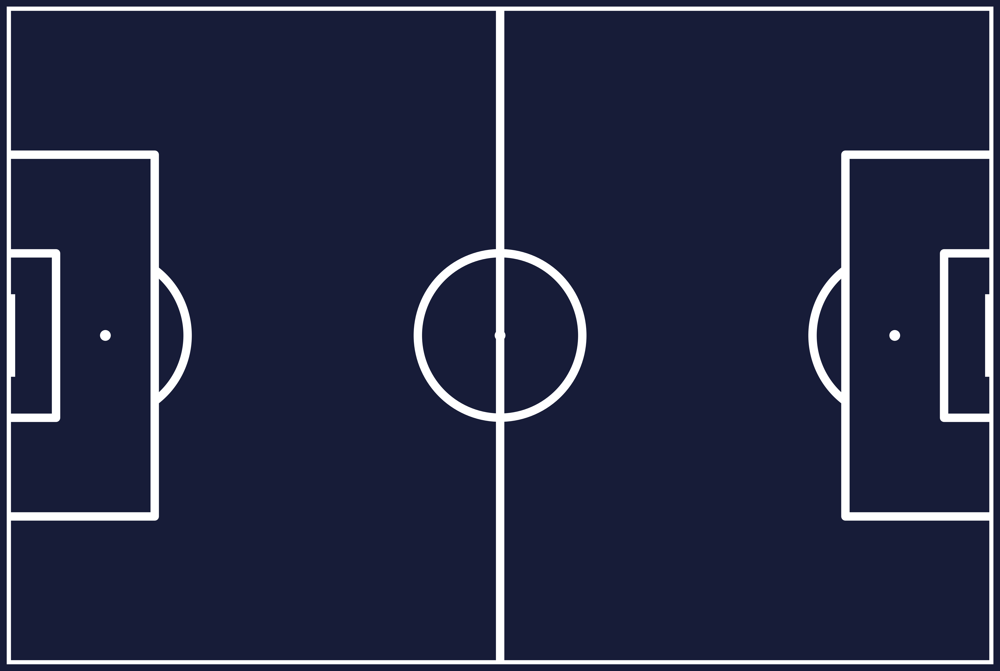

In [19]:
#Warning
warnings.simplefilter(action="ignore", category=FutureWarning)

"""#Set Color
customcmap = LinearSegmentedColormap.from_list('custom cmap', ['#005f60','#008083','#249ea0','#faab36',
                                                               '#f78104','#fd5901','#db2824','#67000d'])"""

customcmap = LinearSegmentedColormap.from_list('custom cmap', ['#171c38','#f79736','#fd5901','#db2824','#67000d'])

#Make the pitch
pitch = Pitch(pitch_type='statsbomb', pitch_color='#171c38', line_color='white',linewidth=9, spot_scale=0.005,line_zorder=1)
fig, ax = pitch.draw(figsize=(15, 11), constrained_layout=False, tight_layout=True)
fig.set_facecolor('#171c38')

#Inverse y-axis
plt.gca().invert_yaxis()

#Set plot boundaries
plt.xlim(0,120)
plt.ylim(0,80)

#Heatmaps of progressive carries origin
kde = sns.kdeplot(carries['endX'], carries['endY'], shade = True, 
                  shade_lowest= False, n_levels=50, linewidths=3, alpha=1, zorder=0.5, cmap=customcmap)

#Title & Annotations
fig.suptitle("Where does "+ player + " Initiate His Carries", fontsize=33, color='yellow',
            fontfamily = "Courier New", fontweight = "bold",y=0.95,x=0.47)

#Credits
ax.text(0.1, -2, 'By: @chunhang7', va='center', ha='left', fontsize=20, color='yellow',
        fontweight = "bold",fontfamily = "Courier New")

ax.text(67.5, -2, 'Credit: @Odriozolite & @GoalAnalysis', va='center', ha='left', fontsize=20, color='yellow',
        fontweight = "bold",fontfamily = "Courier New");

In [ ]:
warnings.simplefilter(action="ignore", category=FutureWarning)

#Make the pitch
pitch = Pitch(pitch_type='statsbomb', pitch_color='#171c38', line_color='white',linewidth=9, spot_scale=0.005,line_zorder=1)
fig, ax = pitch.draw(figsize=(15, 11), constrained_layout=False, tight_layout=True)
fig.set_facecolor('#171c38')

#Inverse y-axis
plt.gca().invert_yaxis()

#Set plot boundaries
plt.xlim(0,120)
plt.ylim(0,80)

#Heatmaps of progressive carries origin
kde = sns.kdeplot(carries['x_next'], carries['y_next'], shade = True, 
                  shade_lowest= False, n_levels=50, linewidths=3, alpha=1, zorder=0.5, cmap=customcmap)

#Title & Annotations
fig.suptitle("Where does "+ player + " Finish His Carries" ,fontsize=33, color='yellow',
            fontfamily = "Courier New", fontweight = "bold",y=0.95,x=0.47)

#Credits
ax.text(0.1, -2, 'By: @chunhang7', va='center', ha='left', fontsize=20, color='yellow',
        fontweight = "bold",fontfamily = "Courier New")

ax.text(67.5, -2, 'Credit: @Odriozolite & @GoalAnalysis', va='center', ha='left', fontsize=20, color='yellow',
        fontweight = "bold",fontfamily = "Courier New");

# Vertical Pitch